# Setup

In [8]:
import os
import glob

import cv2
import numpy as np
from PIL import Image

import pandas as pd
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

from pylibdmtx.pylibdmtx import decode, DmtxSymbolSize
from ultralytics import YOLO, settings
root_dir = os.getcwd().replace('\\notebooks', '')
settings.update({'datasets_dir': f'{root_dir}/data/processed/test', 'runs_dir': f'{root_dir}/yolo/runs'})

import torch
import torch.nn as nn
from torchvision.transforms import v2, InterpolationMode
from torchvision.models.resnet import ResNet18_Weights
from torchvision import models
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Loading Models

In [9]:
model_yolo = YOLO('../yolo/models/ultralytics_finetuned.pt')

In [10]:
# Class definition copied from image_binarizer.ipynb
class binarizer(nn.Module):
    def __init__(self):
        super(binarizer, self).__init__()

        # Load the pretrained ResNet-18 model
        resnet18 = models.resnet18(weights=ResNet18_Weights.DEFAULT)

        # Use the ResNet layers up to the last layer (remove the fully connected layer)
        self.encoder = nn.Sequential(*list(resnet18.children())[:-2]) # output size = 512 x 8 x 8

        # Define the decoder part to upsample back to 512 x 512
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 1, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid() # Use sigmoid for binary output in range [0, 1]
        )

    def forward(self, x):
        '''Pass input through the resnet-18 encoder and custom decoder'''
        # print('FORWARD A')
        x = self.encoder(x)
        # print('FORWARD B')
        x = self.decoder(x)
        return x

# Load the trained model
model_binarizer = binarizer().to(device)
model_binarizer.load_state_dict(torch.load('../torch/binarizer_0.pt'))
model_binarizer.eval()

binarizer(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=Tru

In [11]:
# Function to prepare image for model input
def prepare_image(img):
    transform = v2.Compose([
        v2.Resize((512, 512), interpolation=InterpolationMode.BILINEAR), # Resize to match model input
        v2.ToImage(),
        v2.ToDtype(torch.float32, scale=True),
        v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]) # ResNet normalization
    ])

    img = transform(img).unsqueeze(0).to(device)
    return img

(512, 512)


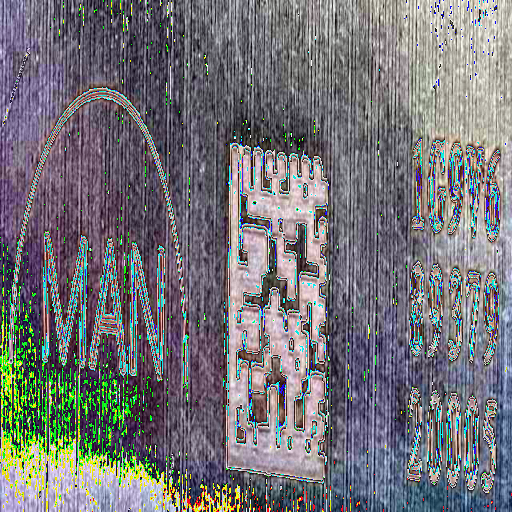

In [12]:
# testing image preparer
img = Image.open('../data/MAN/images/test/1G9V68937920005_jpeg.rf.8cf4ab8c3c91d302bcc6d81776399c39.jpg')
img = prepare_image(img)
img = v2.ToPILImage()(img[0].squeeze(0))
print(img.size)
display(img)

## Evaluation Function

In [13]:
def decoding_pipeline(yolo_model, binarizer_model, test_data_path):
    '''
    Performs cropping and decoding of the images
    '''
    img_paths = glob.glob(test_data_path)

    # stat tracking
    num_decodings = 0
    num_valid_decodings = 0

    imgs = []
    titles = []

    idx = 0
    for img_path in img_paths:
        img = cv2.imread(img_path)
        results = yolo_model(img)
        boxes = results[0].boxes.xyxy.tolist()

        actual_decoding = os.path.basename(img_path).split('_')[0]
        actual_decoding = actual_decoding.replace('-', '') # minor cleaning

        # fixing some actual decodings
        if actual_decoding == 'KV8INMEP':
            actual_decoding = '#D1FPE50HA9NS0047XG264##KV8INMEP'
        elif actual_decoding == 'KW8PXY3D':
            actual_decoding = '#D1FPE50HA9NS0047XG264##KW8PXY3D'

        if boxes != None and len(boxes) > 0:
            # only look at box with highest confidence
            box = boxes[0]

            # crop with some padding (to not have too small of a crop)
            pad = 45
            crop_obj = img[max(0, int(box[1])-pad):max(0, int(box[3])+pad), max(0, int(box[0])-pad):max(0, int(box[2])+pad)]

            # convert image for use in binarizer
            crop_obj = Image.fromarray(crop_obj)
            crop_obj_prep = prepare_image(crop_obj)
            display(v2.ToPILImage()(crop_obj_prep[0].squeeze(0)))

            # binarize with model
            output = binarizer_model(crop_obj_prep)

            # binarize with threshold
            pred = (output > 0.5).float()
            display(v2.ToPILImage()(pred[0].squeeze(0)))

            # convert to numpy for decoding
            converted = pred[0].squeeze(0).cpu().numpy().astype(np.uint8) * 255
            # display(Image.fromarray(converted))
            
            # decode with params used in data synthesis
            decoded = decode(converted,
                             max_count=1,
                             threshold=50,
                             min_edge= 20,
                             max_edge=800,
                             shape=DmtxSymbolSize.DmtxSymbol16x16,
                             timeout=1000,
                             )

            if decoded:
                num_decodings += 1

                decoded_string = decoded[0].data.decode('utf-8')

                if decoded_string == actual_decoding:
                    print(f'Valid decoding! {actual_decoding}')
                    num_valid_decodings += 1
                    imgs.append(Image.fromarray(converted))
                    titles.append(actual_decoding)
                else:
                    print('Invalid decoding!')
                    print(actual_decoding)
                    print(decoded_string)

            # optional saving
            cv2.imwrite(f'../data/cropped/{actual_decoding}-{idx}.jpg', crop_obj)
            idx += 1

    # calculate stats
    dm_decode_rate = num_decodings/len(img_paths)
    valid_decode_rate = num_valid_decodings/len(img_paths)

    print()
    print(f'{num_valid_decodings}/{len(img_paths)}')
    print(f'Dm decode rate: {dm_decode_rate}')
    print(f'Valid decode rate: {valid_decode_rate}')
    # print_save_imgs(imgs, titles, fig_title)

# Running Evaluation


0: 640x640 1 Data Matrix, 74.6ms
Speed: 15.1ms preprocess, 74.6ms inference, 74.2ms postprocess per image at shape (1, 3, 640, 640)


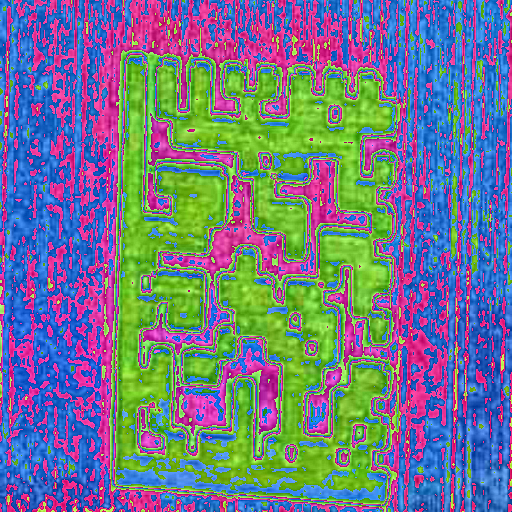

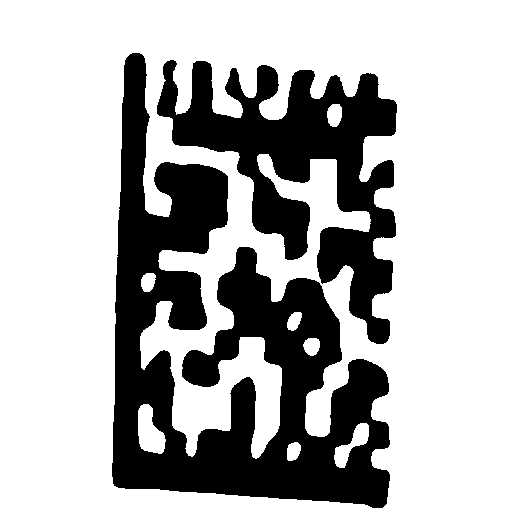

Valid decoding! 1G9V68937920005

0: 640x640 1 Data Matrix, 19.3ms
Speed: 3.0ms preprocess, 19.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


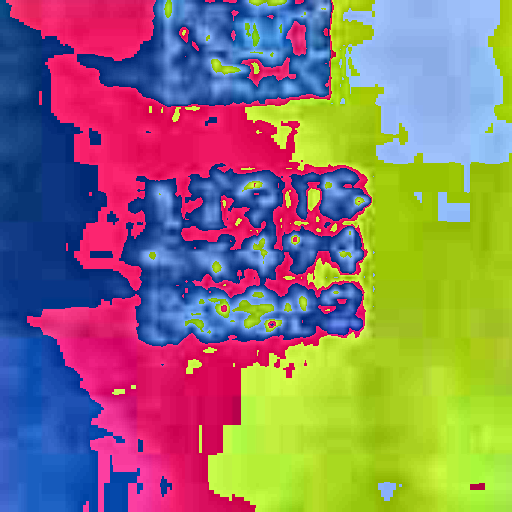

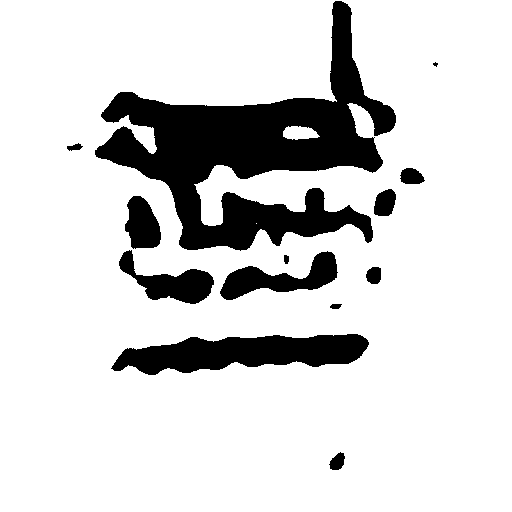


0: 640x640 1 Data Matrix, 22.0ms
Speed: 3.0ms preprocess, 22.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


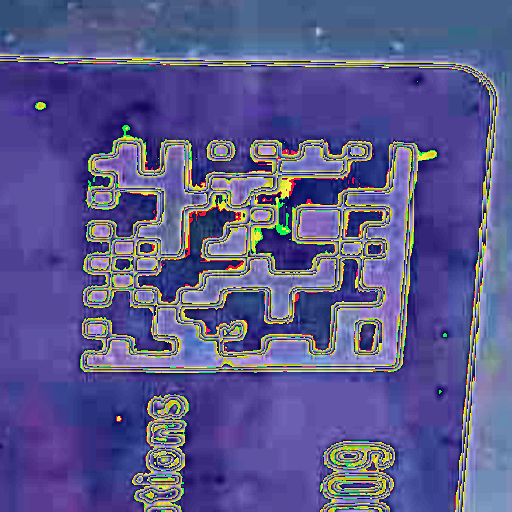

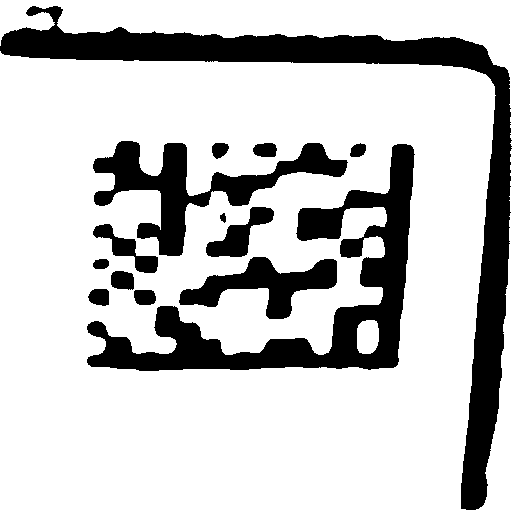


0: 640x640 1 Data Matrix, 100.1ms
Speed: 4.0ms preprocess, 100.1ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


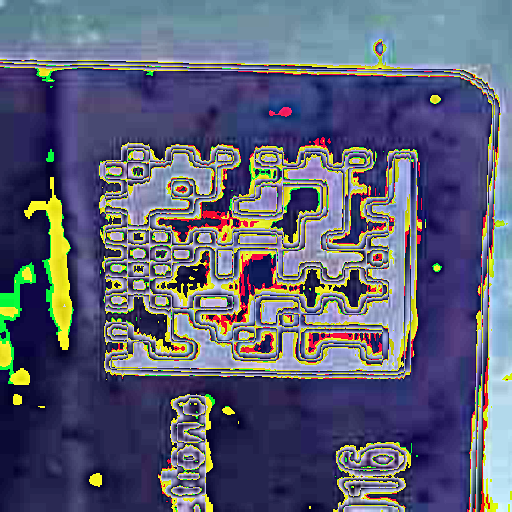

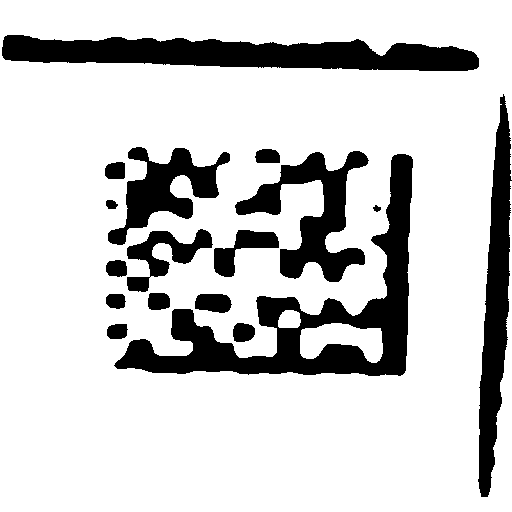


0: 640x640 1 Data Matrix, 14.0ms
Speed: 3.0ms preprocess, 14.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


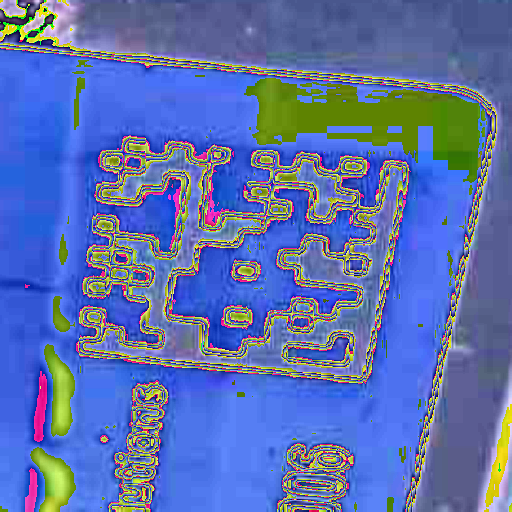

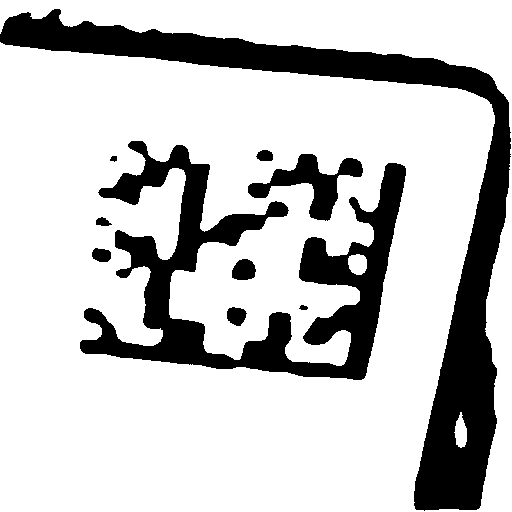


0: 640x640 1 Data Matrix, 74.0ms
Speed: 4.0ms preprocess, 74.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


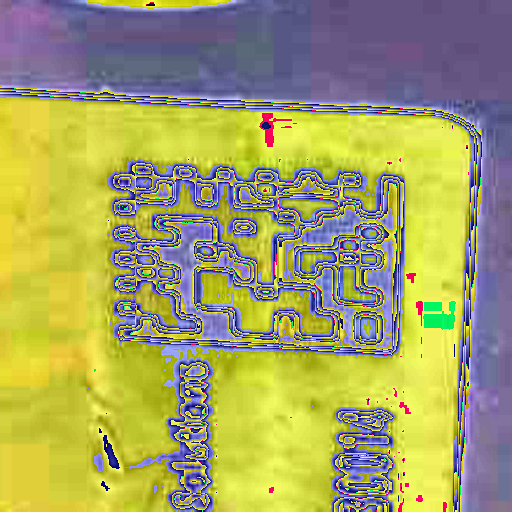

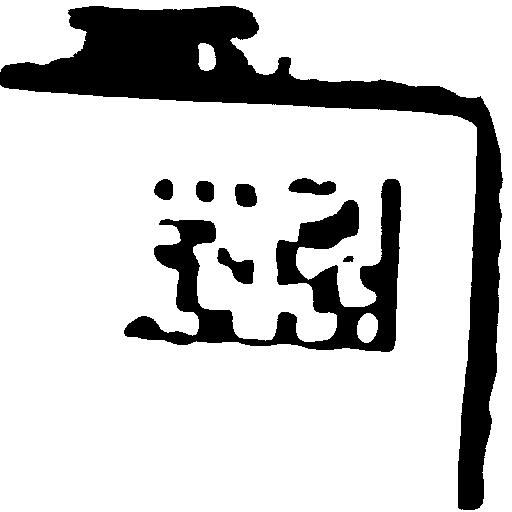


0: 640x640 1 Data Matrix, 28.0ms
Speed: 3.0ms preprocess, 28.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


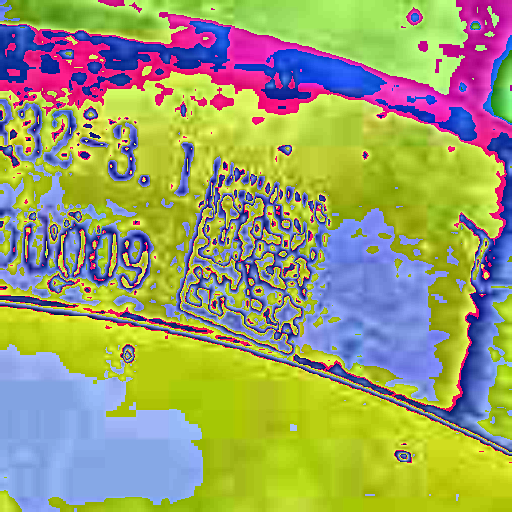

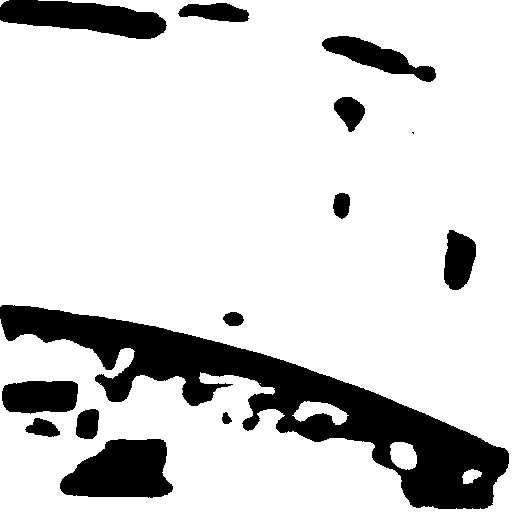


0: 640x640 1 Data Matrix, 194.4ms
Speed: 35.1ms preprocess, 194.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


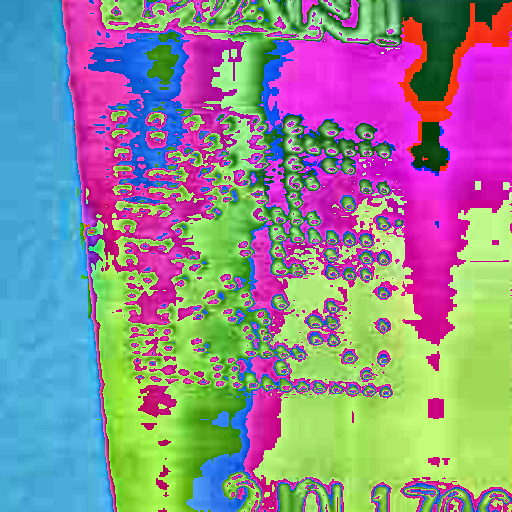

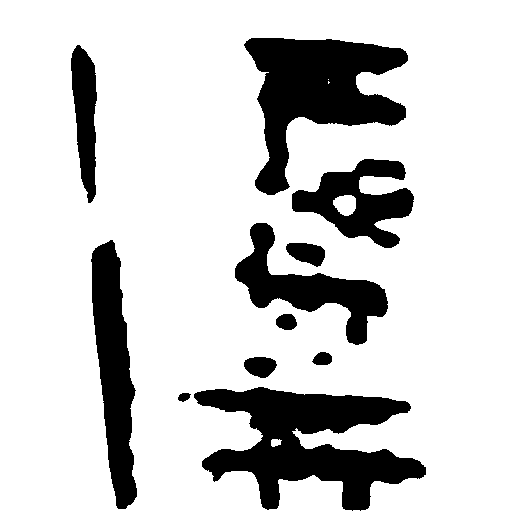


0: 640x640 1 Data Matrix, 7.0ms
Speed: 2.0ms preprocess, 7.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


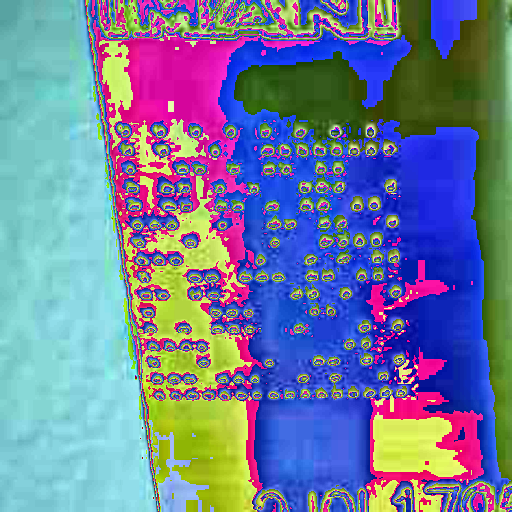

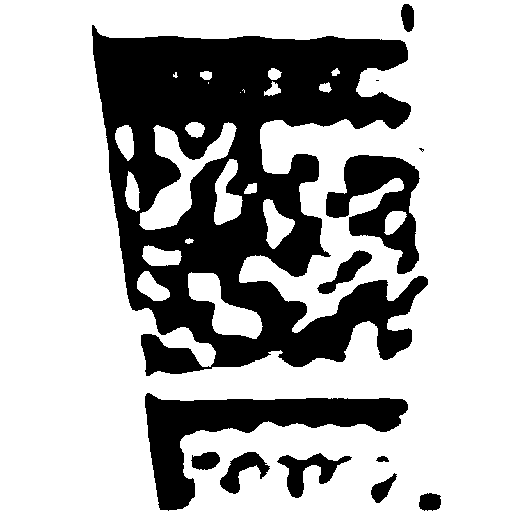


0: 640x640 1 Data Matrix, 20.0ms
Speed: 3.0ms preprocess, 20.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


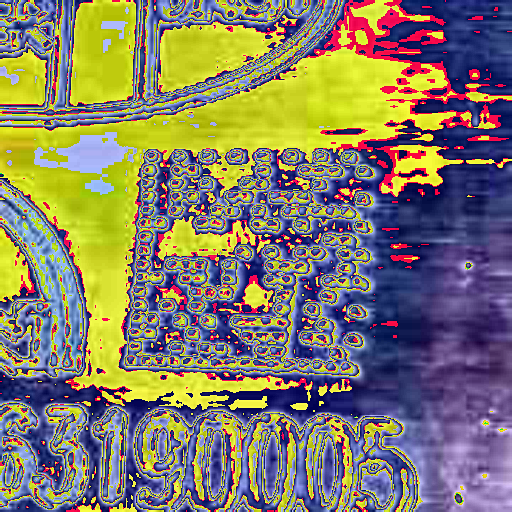

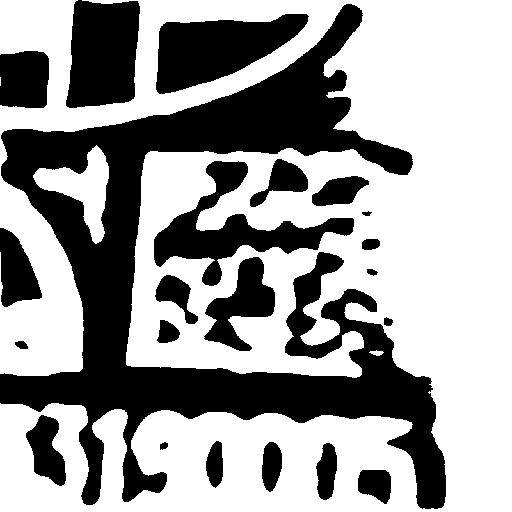


0: 640x640 1 Data Matrix, 149.3ms
Speed: 4.0ms preprocess, 149.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


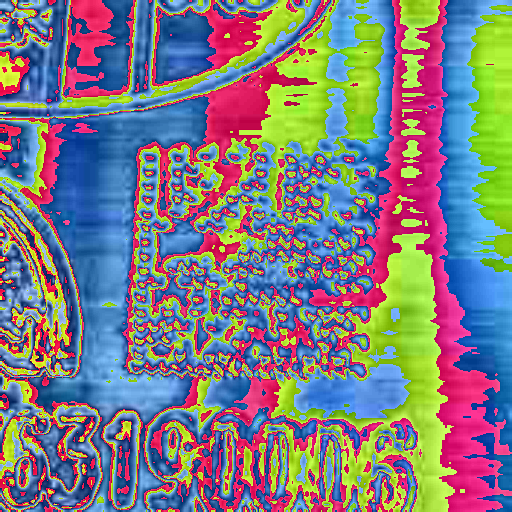

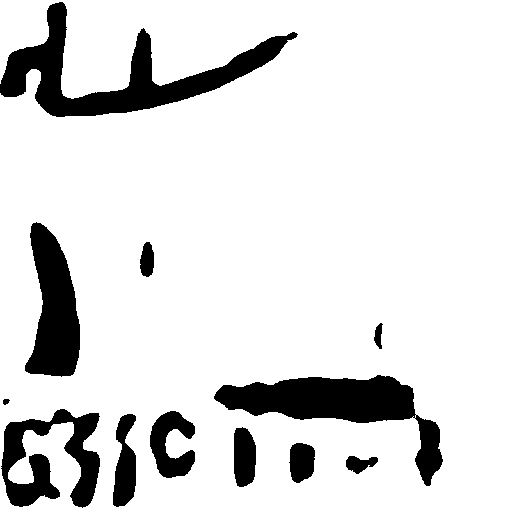


0: 640x640 2 Data Matrixs, 20.1ms
Speed: 2.0ms preprocess, 20.1ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


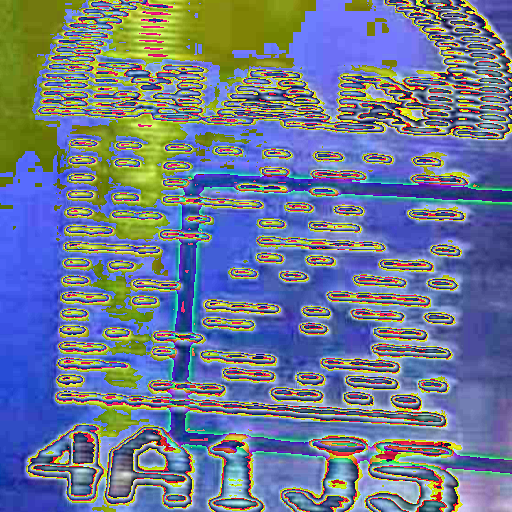

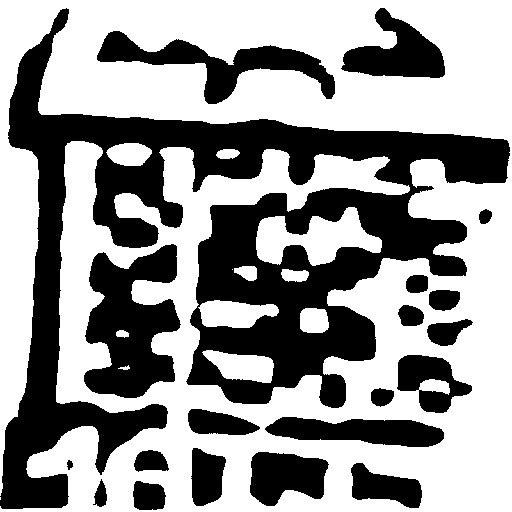


0: 640x640 1 Data Matrix, 104.6ms
Speed: 4.0ms preprocess, 104.6ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


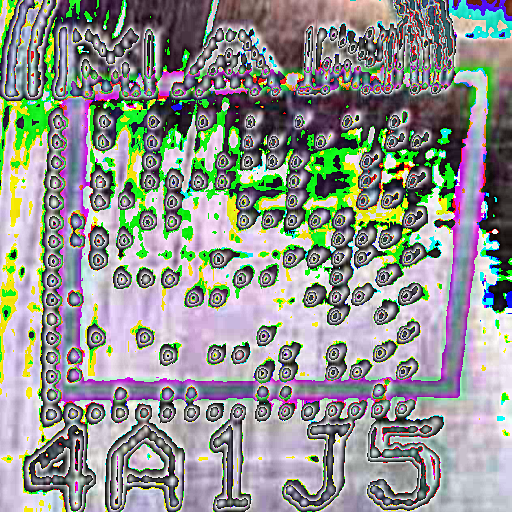

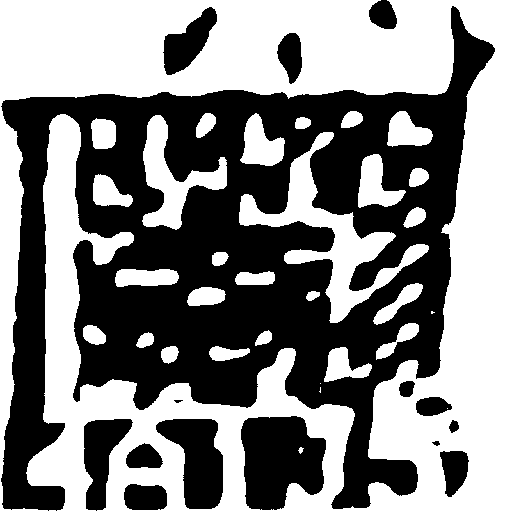


0: 640x640 2 Data Matrixs, 21.5ms
Speed: 3.0ms preprocess, 21.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


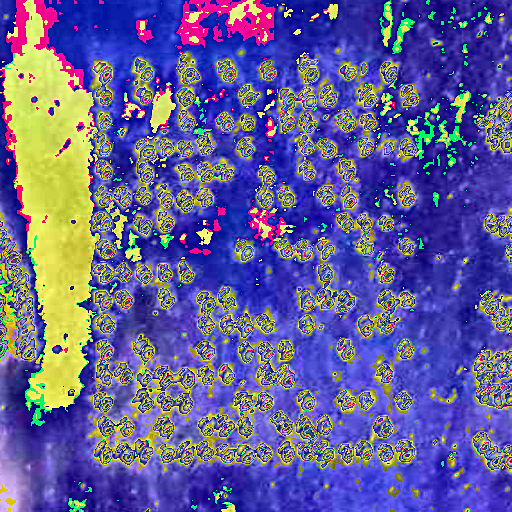

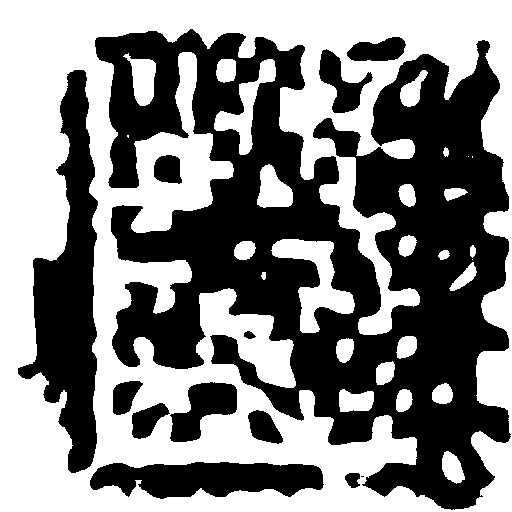


0: 640x640 1 Data Matrix, 103.8ms
Speed: 4.0ms preprocess, 103.8ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


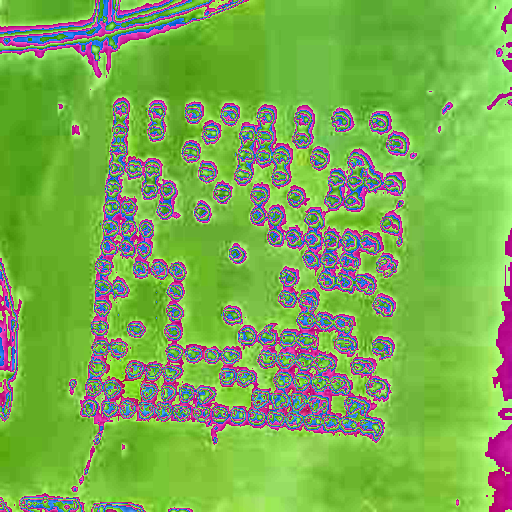

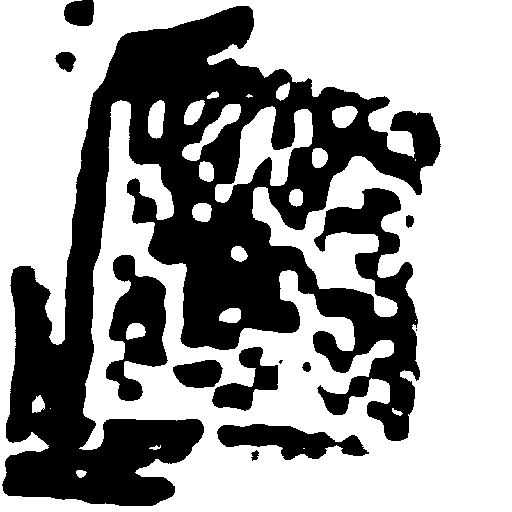


0: 640x640 (no detections), 8.0ms
Speed: 3.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Data Matrix, 10.0ms
Speed: 3.0ms preprocess, 10.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


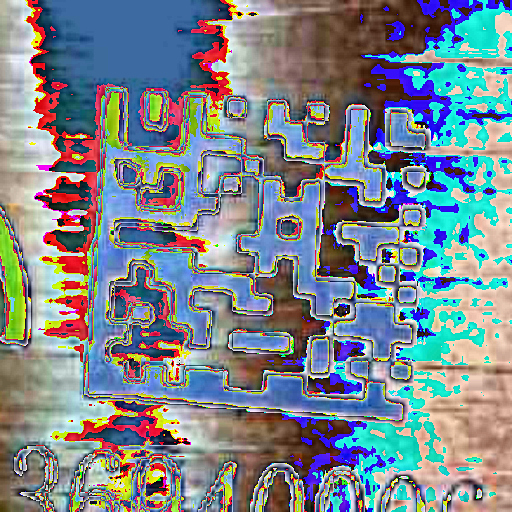

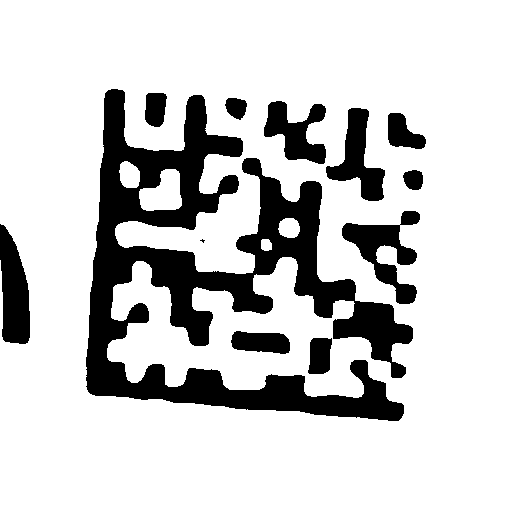

Valid decoding! 4F1K99136940006

0: 640x640 1 Data Matrix, 12.0ms
Speed: 2.0ms preprocess, 12.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


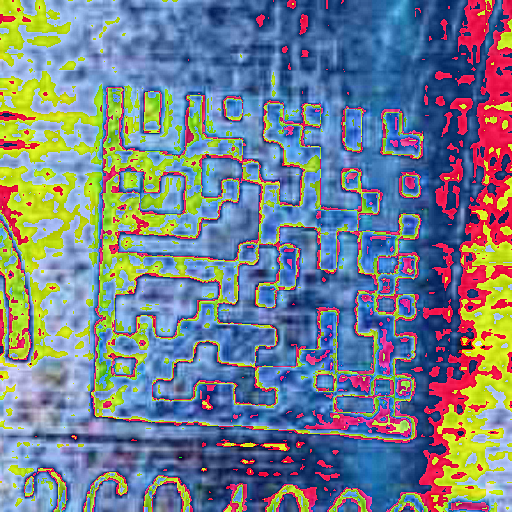

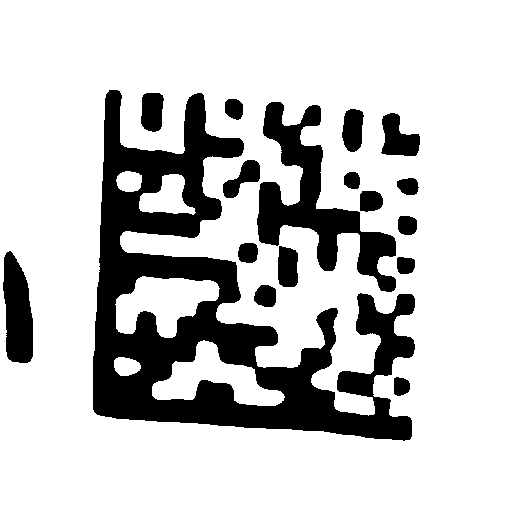

Valid decoding! 4F1K99136940007

0: 640x640 3 Data Matrixs, 7.0ms
Speed: 3.0ms preprocess, 7.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


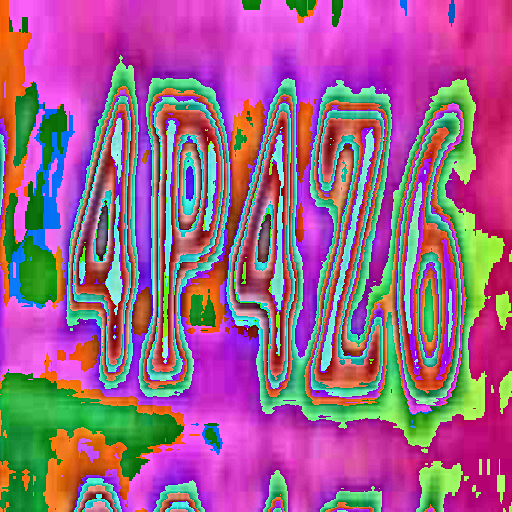

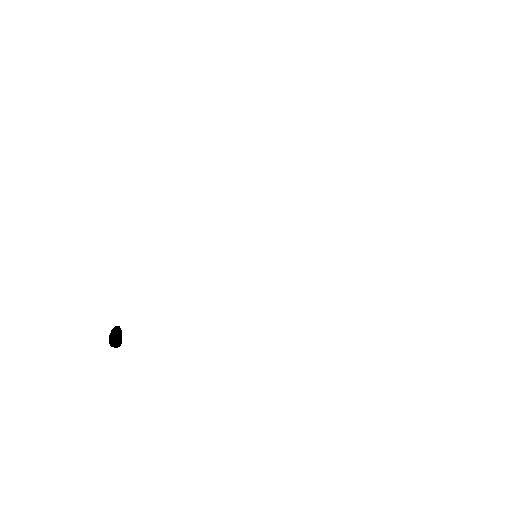


0: 640x640 1 Data Matrix, 7.0ms
Speed: 3.0ms preprocess, 7.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


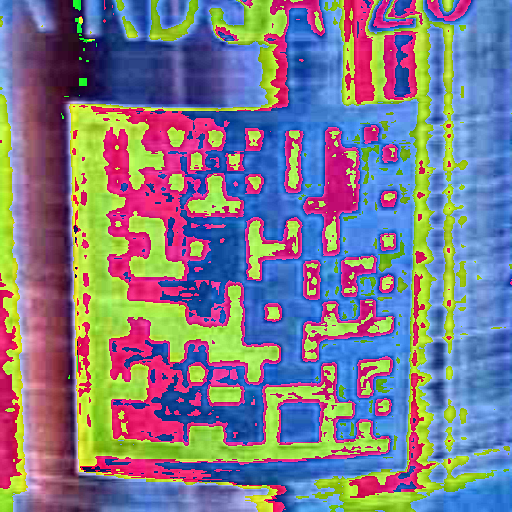

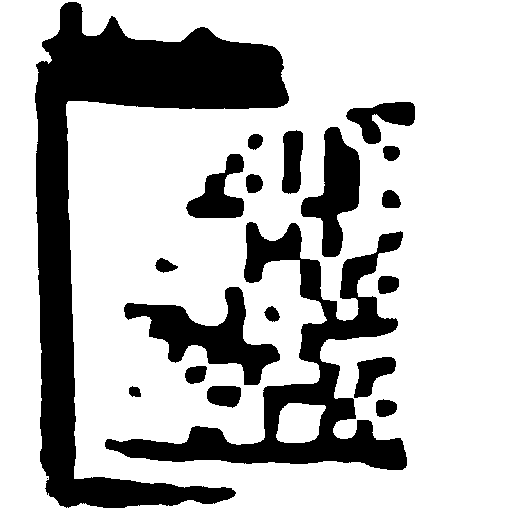


0: 640x640 (no detections), 27.1ms
Speed: 3.0ms preprocess, 27.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Data Matrix, 18.1ms
Speed: 10.0ms preprocess, 18.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


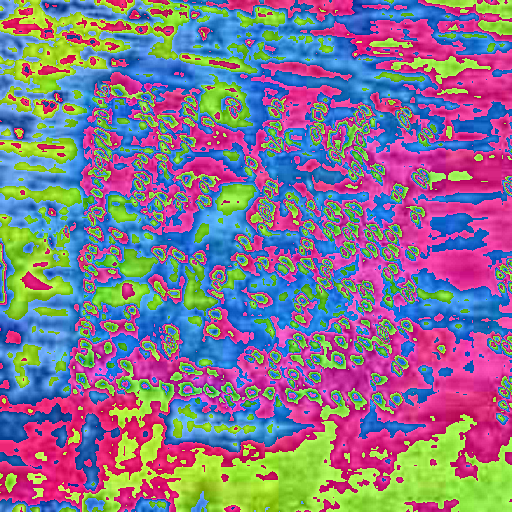

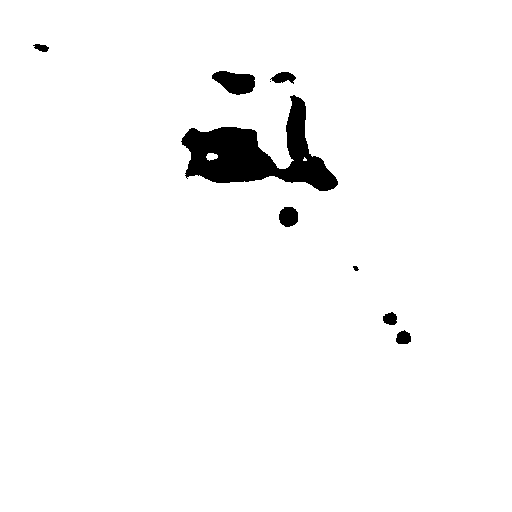


0: 640x640 2 Data Matrixs, 18.0ms
Speed: 7.0ms preprocess, 18.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


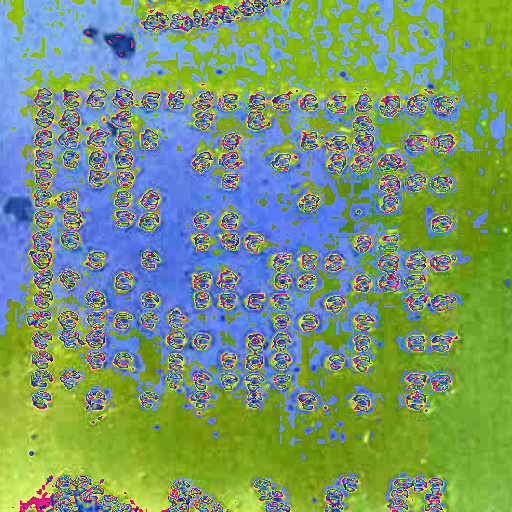

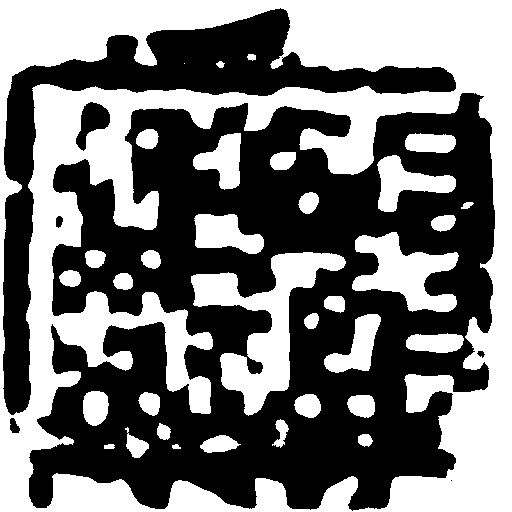


0: 640x640 1 Data Matrix, 17.0ms
Speed: 2.0ms preprocess, 17.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


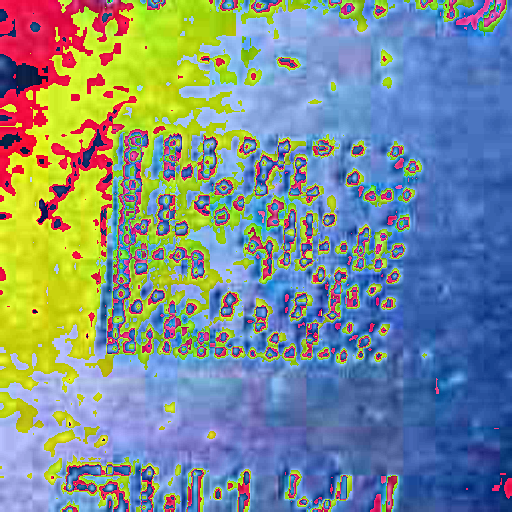

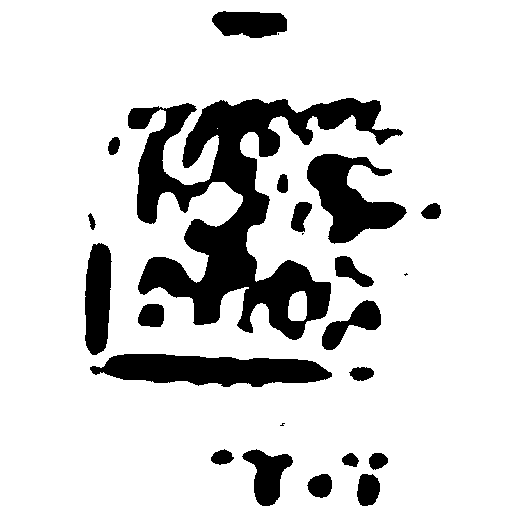


0: 640x640 1 Data Matrix, 53.6ms
Speed: 44.1ms preprocess, 53.6ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


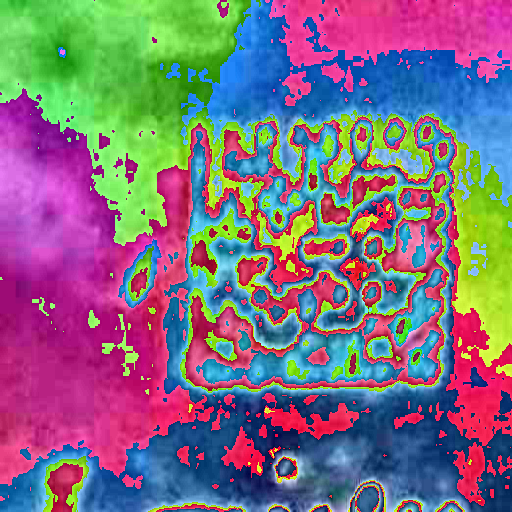

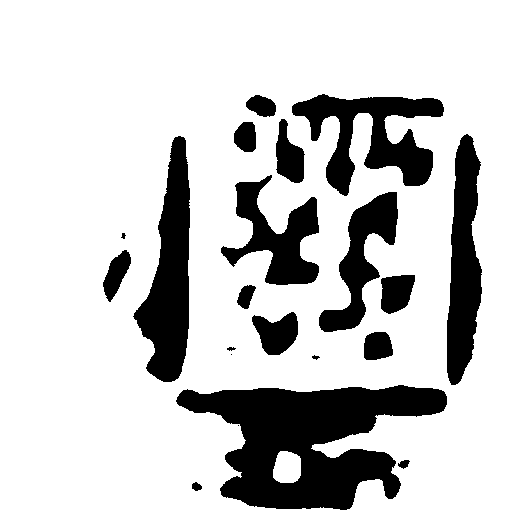


0: 640x640 (no detections), 7.0ms
Speed: 2.0ms preprocess, 7.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Data Matrix, 11.5ms
Speed: 3.0ms preprocess, 11.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


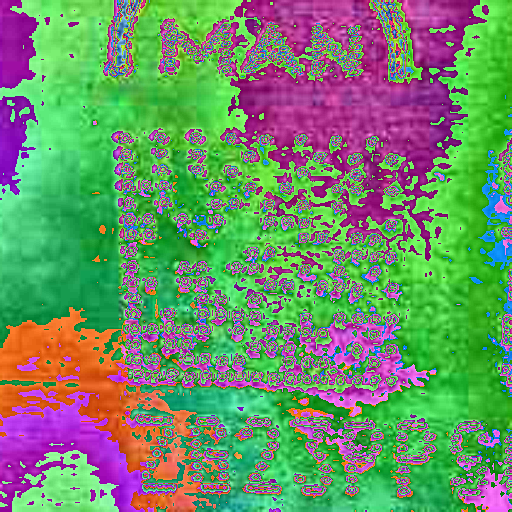

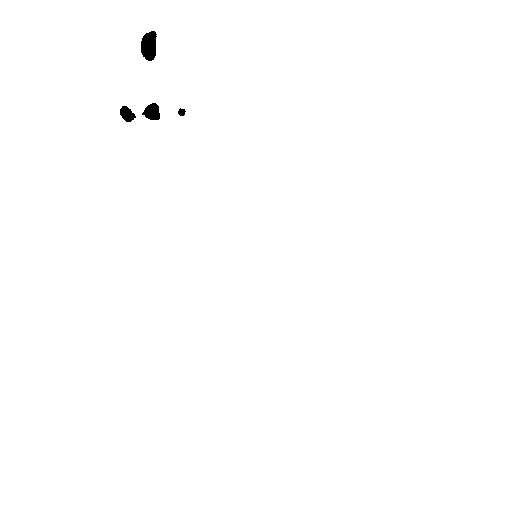


0: 640x640 2 Data Matrixs, 8.0ms
Speed: 3.0ms preprocess, 8.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


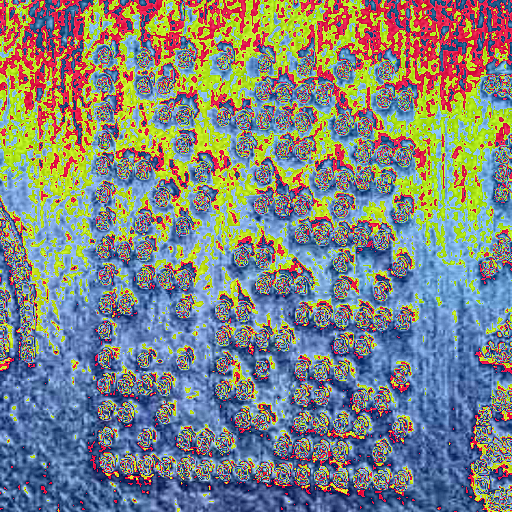

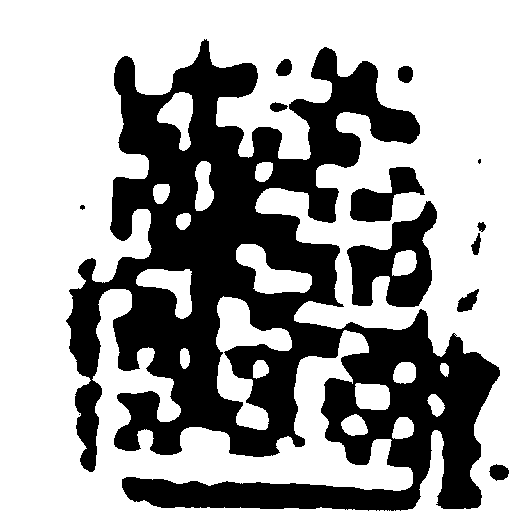


0: 640x640 3 Data Matrixs, 19.0ms
Speed: 3.0ms preprocess, 19.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


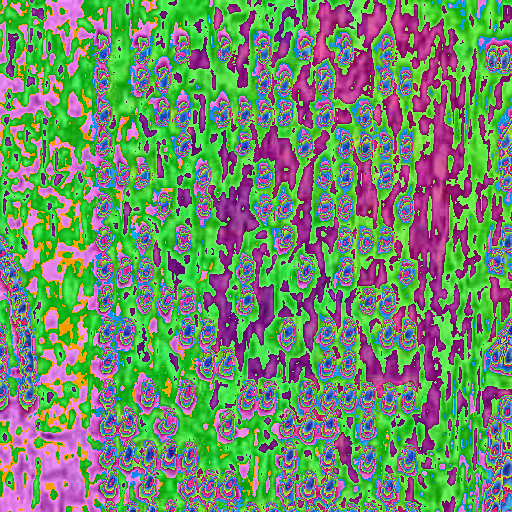

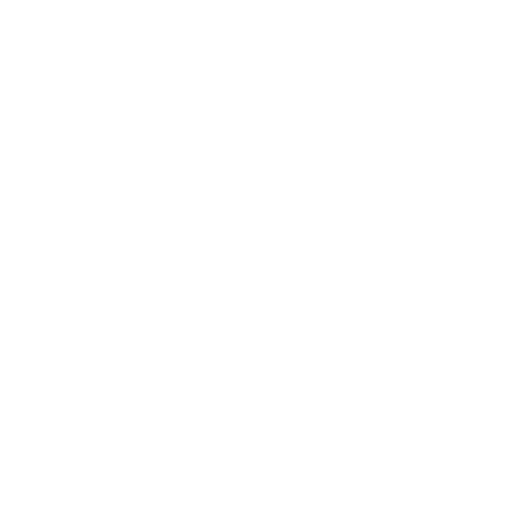


0: 640x640 1 Data Matrix, 19.0ms
Speed: 4.0ms preprocess, 19.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


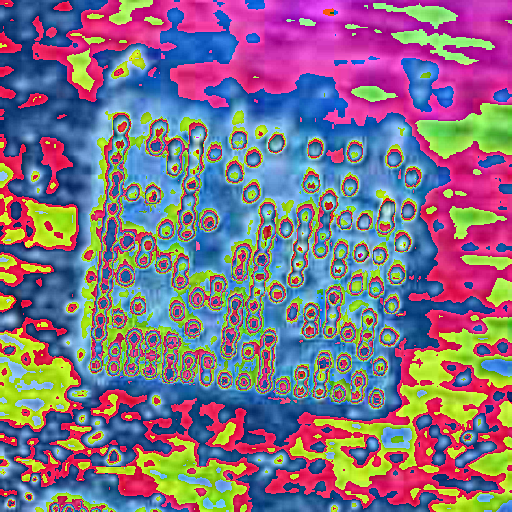

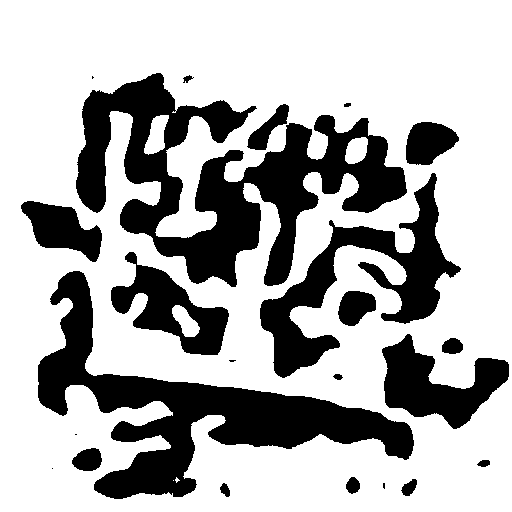


0: 640x640 1 Data Matrix, 113.6ms
Speed: 4.0ms preprocess, 113.6ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


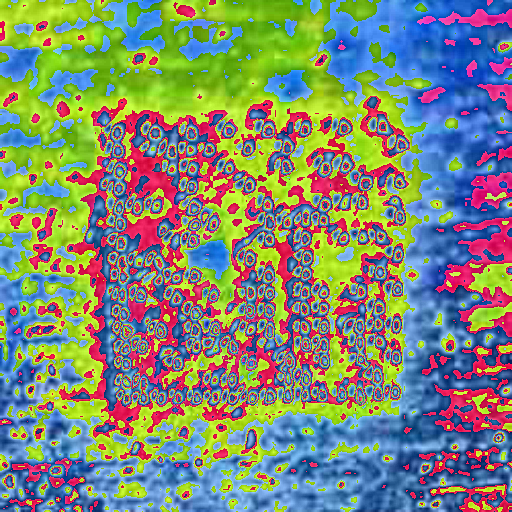

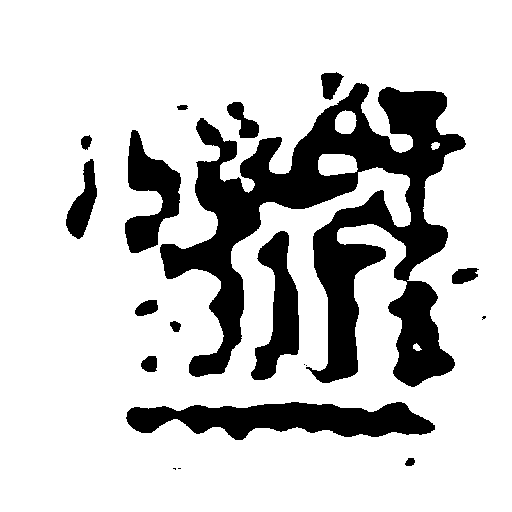


0: 640x640 1 Data Matrix, 15.0ms
Speed: 4.0ms preprocess, 15.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


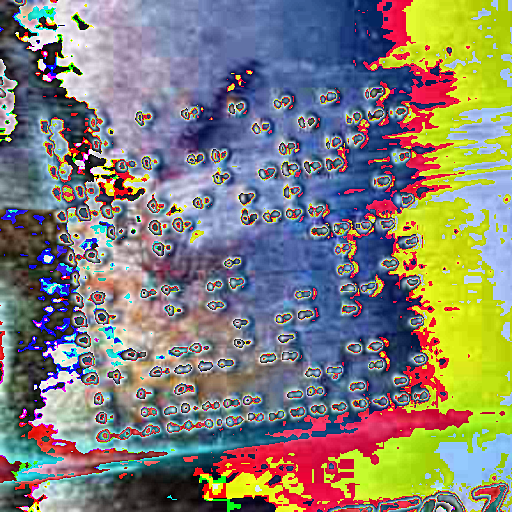

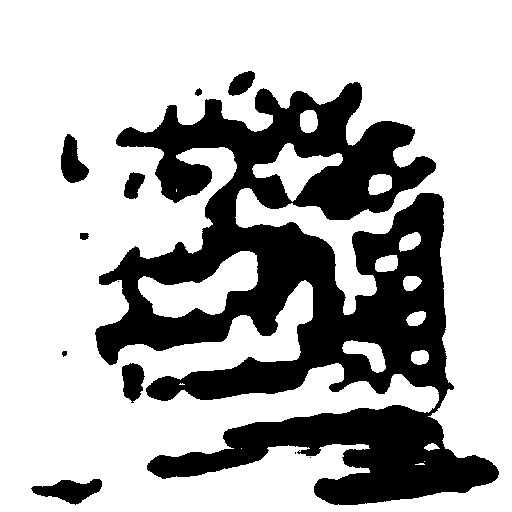


0: 640x640 1 Data Matrix, 42.0ms
Speed: 5.0ms preprocess, 42.0ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


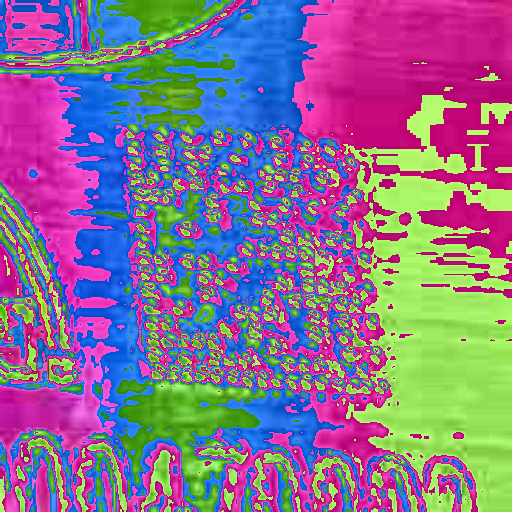

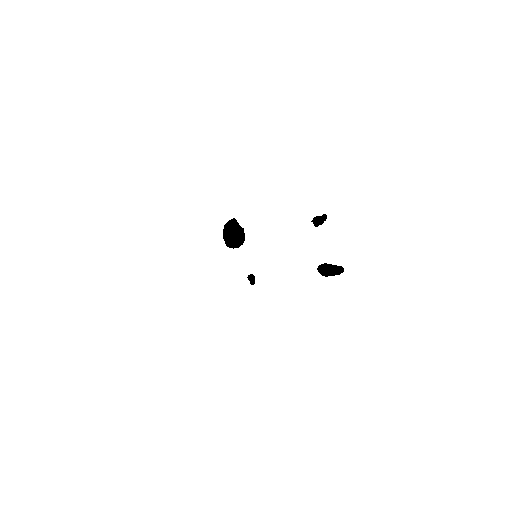


0: 640x640 1 Data Matrix, 8.0ms
Speed: 3.0ms preprocess, 8.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


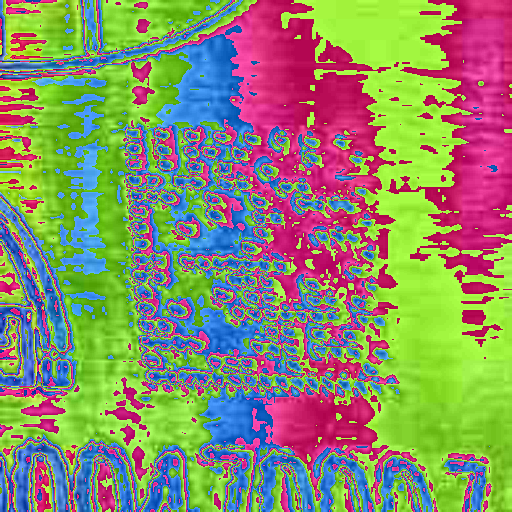

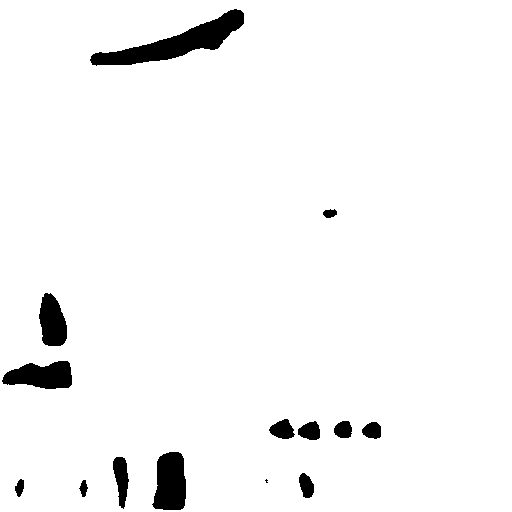


0: 640x640 2 Data Matrixs, 8.0ms
Speed: 2.0ms preprocess, 8.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


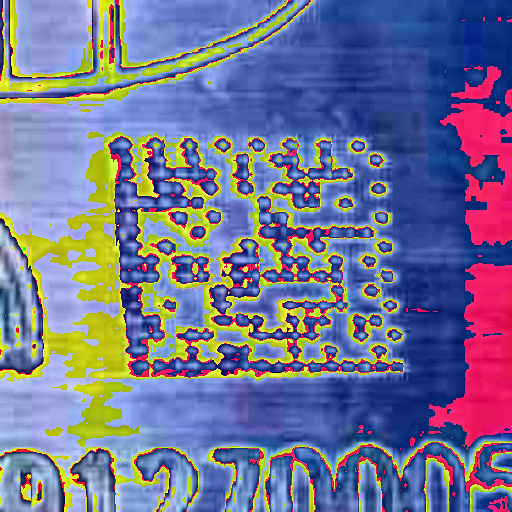

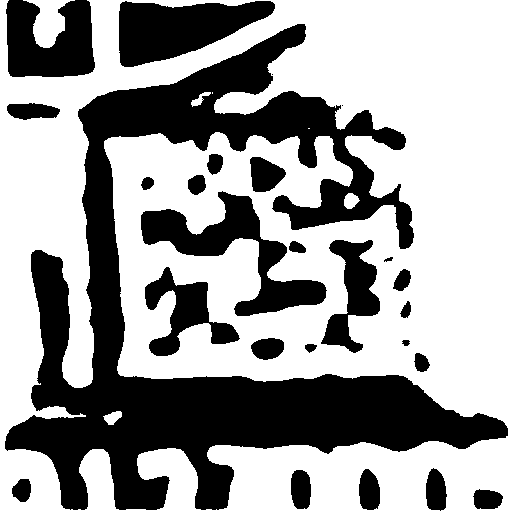


0: 640x640 1 Data Matrix, 7.0ms
Speed: 2.0ms preprocess, 7.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


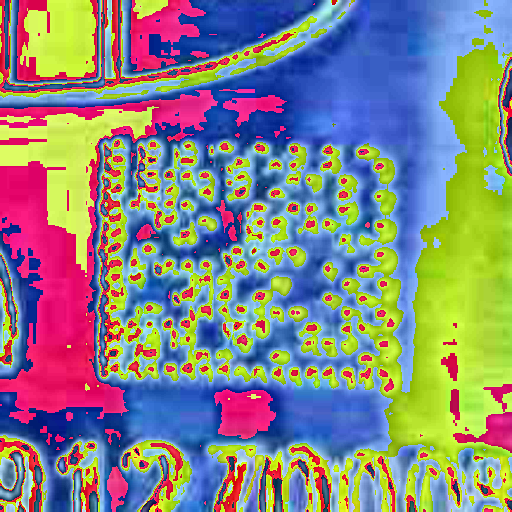

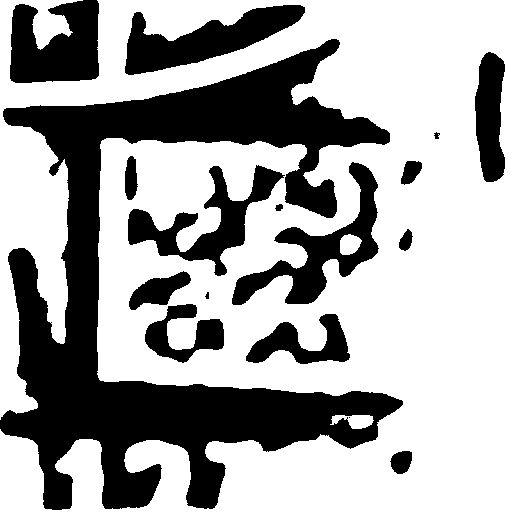


0: 640x640 1 Data Matrix, 82.3ms
Speed: 4.0ms preprocess, 82.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


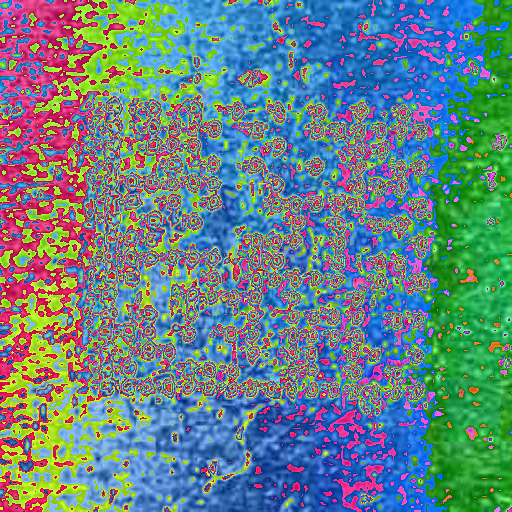

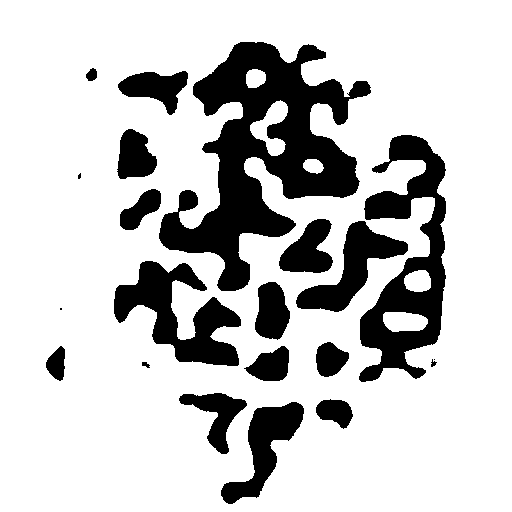


0: 640x640 1 Data Matrix, 36.4ms
Speed: 4.0ms preprocess, 36.4ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)


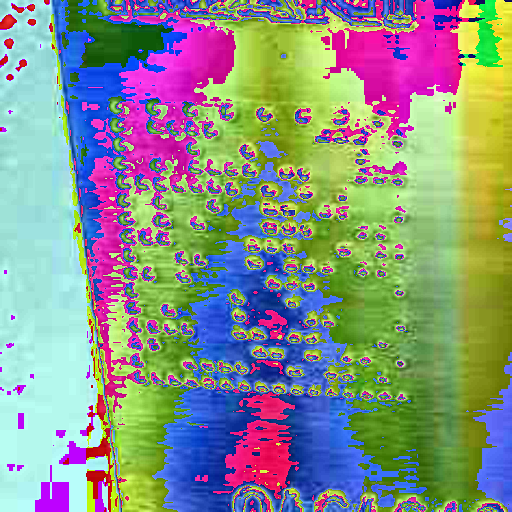

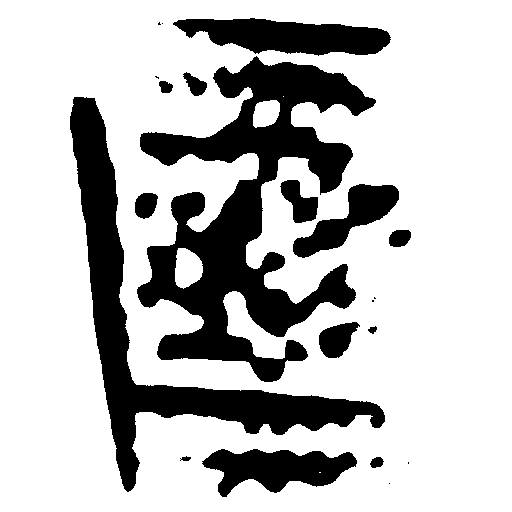


0: 640x640 1 Data Matrix, 9.0ms
Speed: 4.0ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


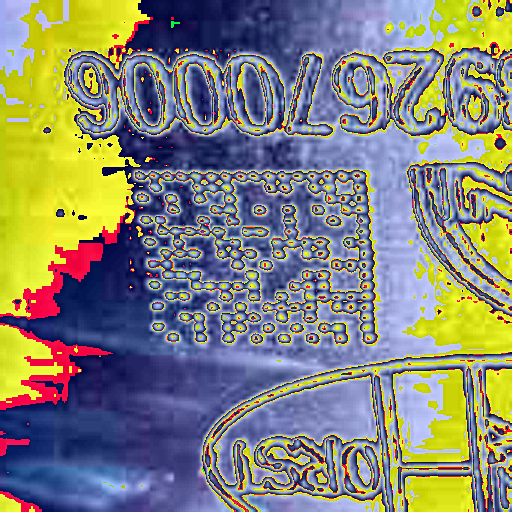

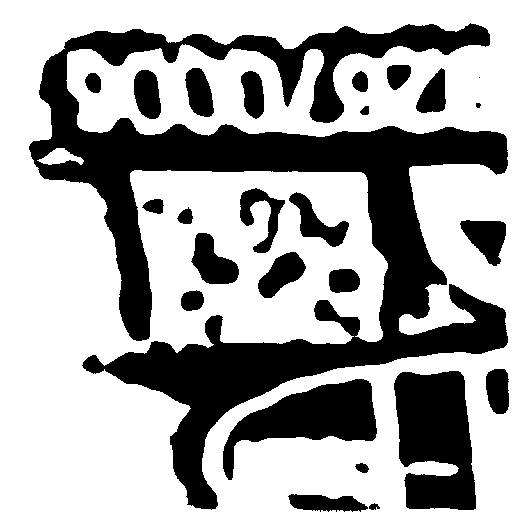


0: 640x640 1 Data Matrix, 11.0ms
Speed: 2.0ms preprocess, 11.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


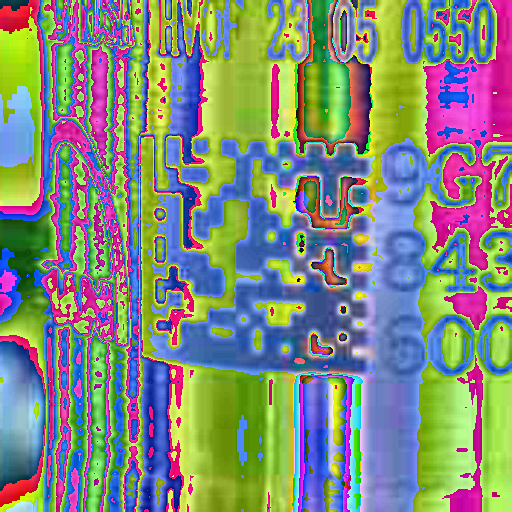

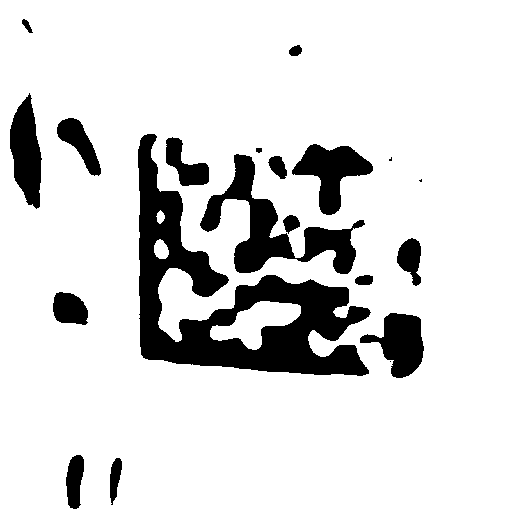


0: 640x640 1 Data Matrix, 8.0ms
Speed: 2.0ms preprocess, 8.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


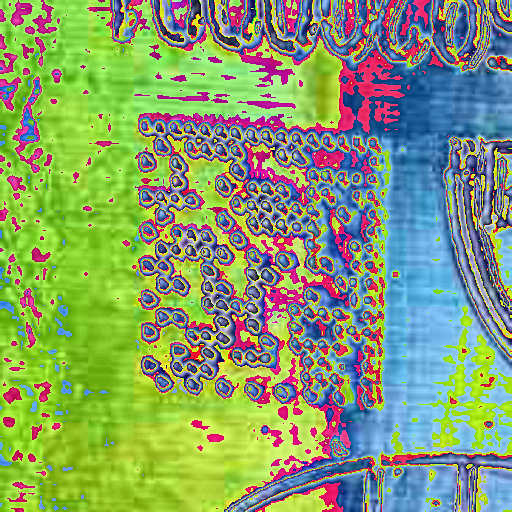

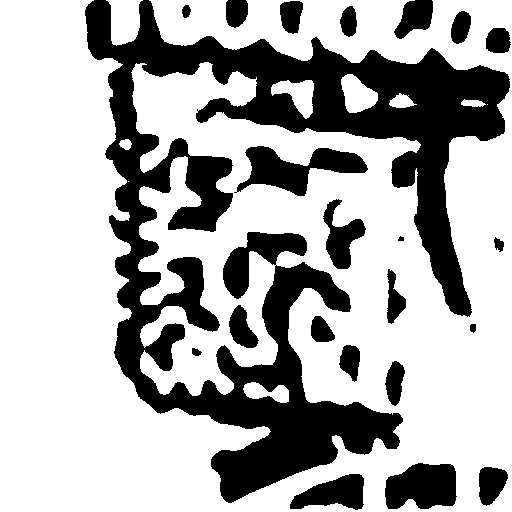


0: 640x640 1 Data Matrix, 18.0ms
Speed: 3.0ms preprocess, 18.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


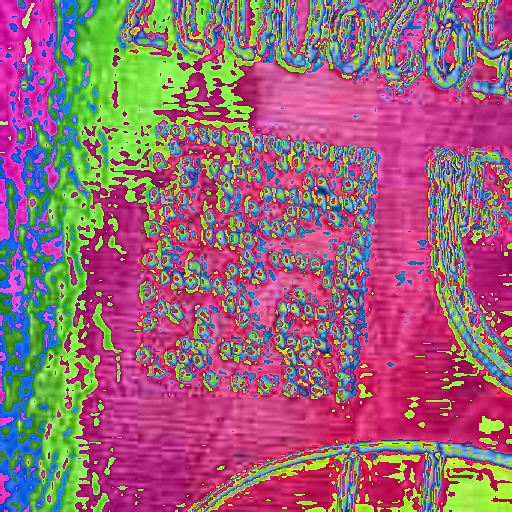

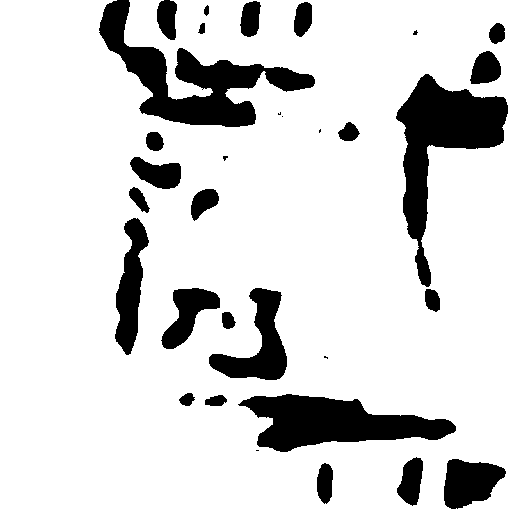


0: 640x640 5 Data Matrixs, 11.0ms
Speed: 2.0ms preprocess, 11.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


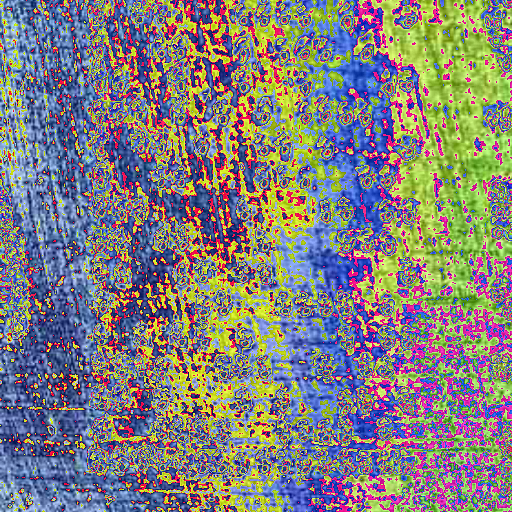

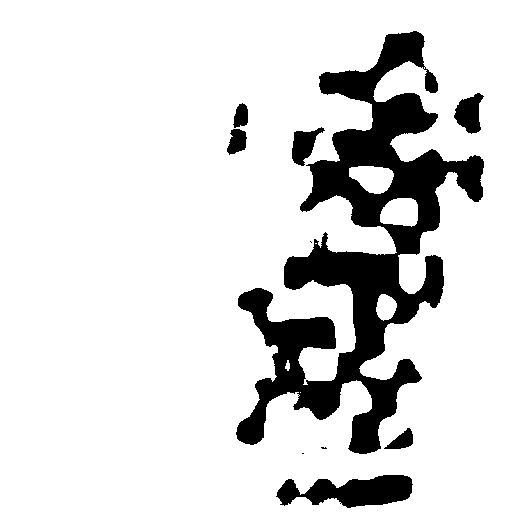


0: 640x640 1 Data Matrix, 18.0ms
Speed: 3.0ms preprocess, 18.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


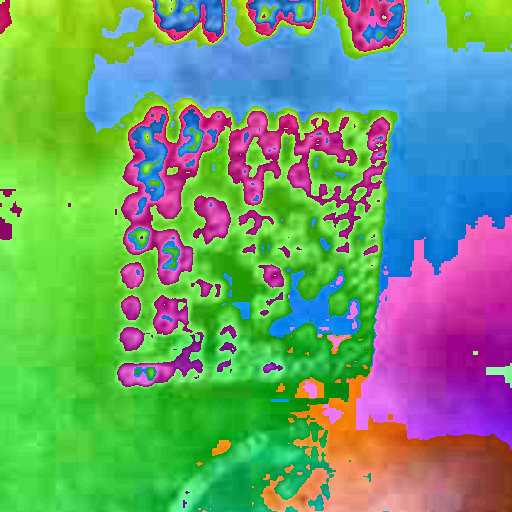

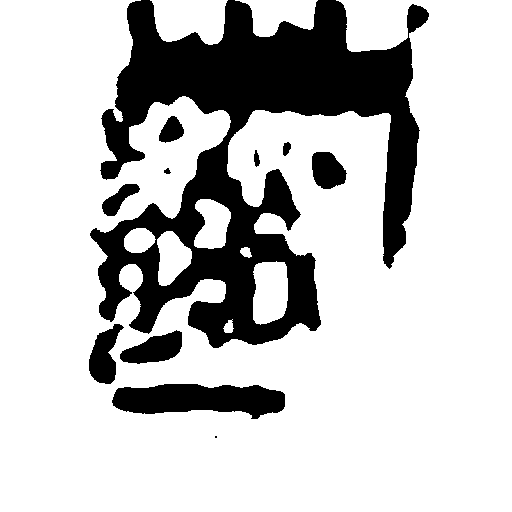


0: 640x640 1 Data Matrix, 205.3ms
Speed: 5.0ms preprocess, 205.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


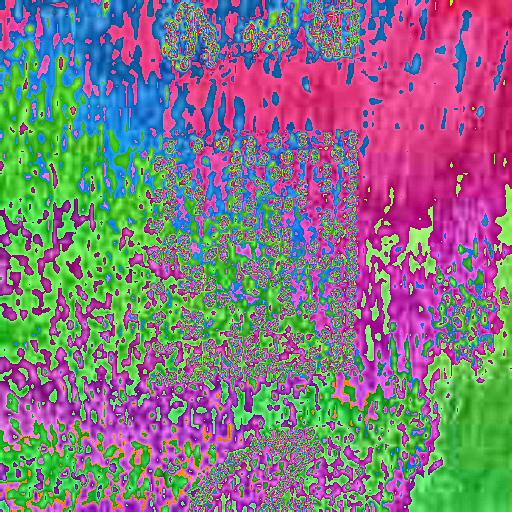

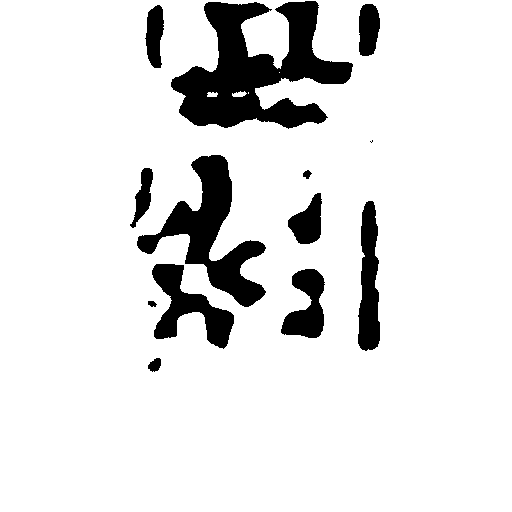


0: 640x640 1 Data Matrix, 9.0ms
Speed: 2.0ms preprocess, 9.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


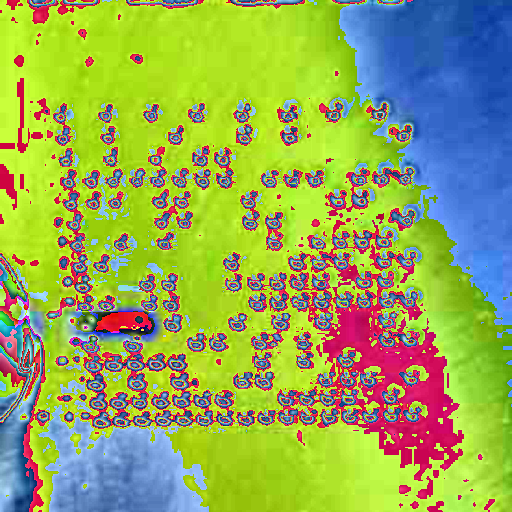

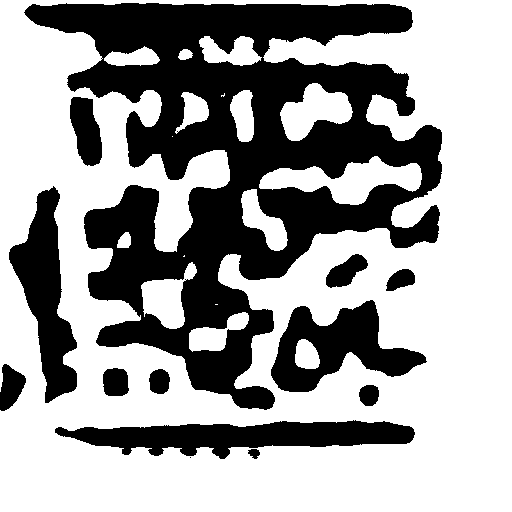


0: 640x640 1 Data Matrix, 11.0ms
Speed: 2.0ms preprocess, 11.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


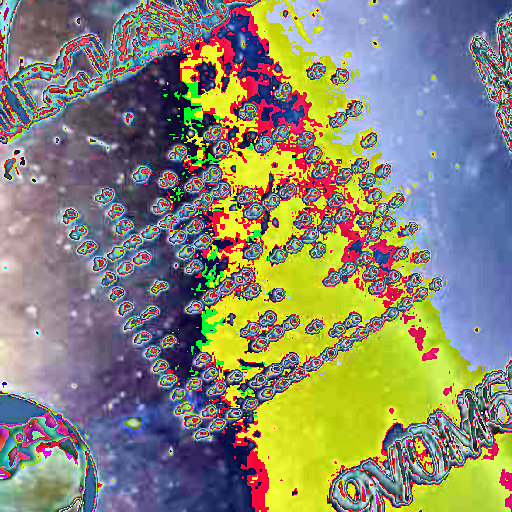

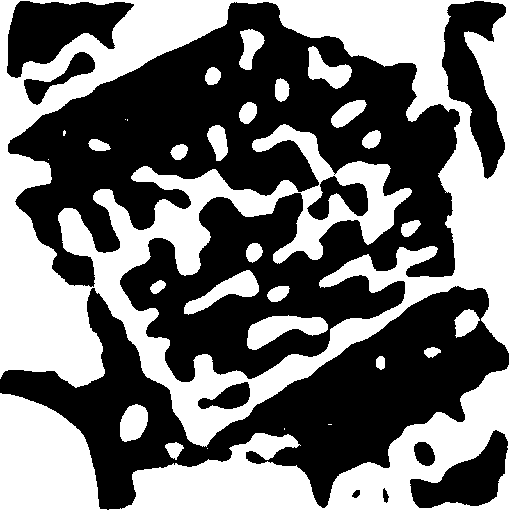


0: 640x640 1 Data Matrix, 9.5ms
Speed: 3.0ms preprocess, 9.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


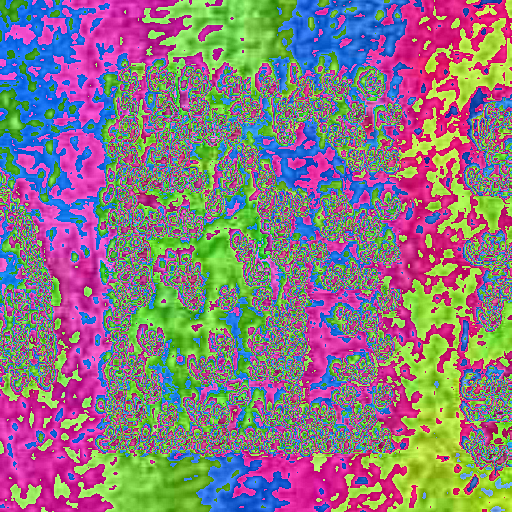

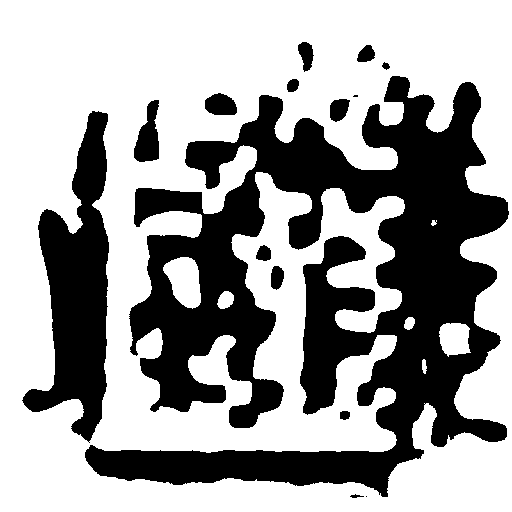


0: 640x640 1 Data Matrix, 11.0ms
Speed: 226.4ms preprocess, 11.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


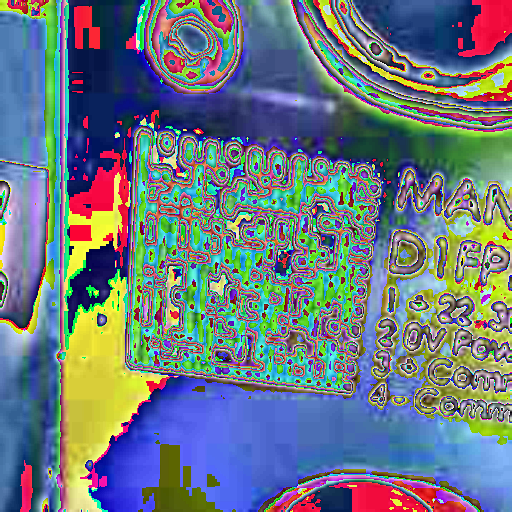

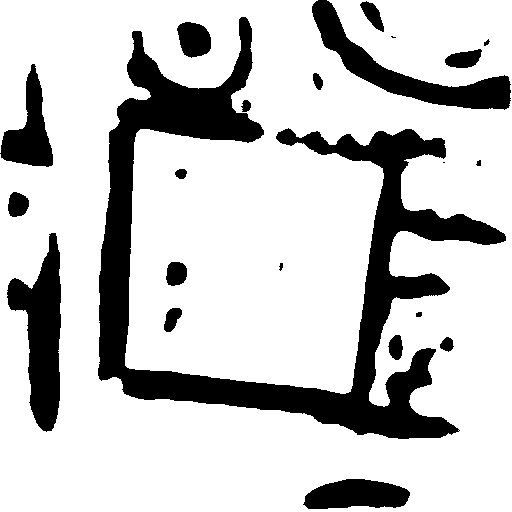


0: 640x640 1 Data Matrix, 12.0ms
Speed: 3.0ms preprocess, 12.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


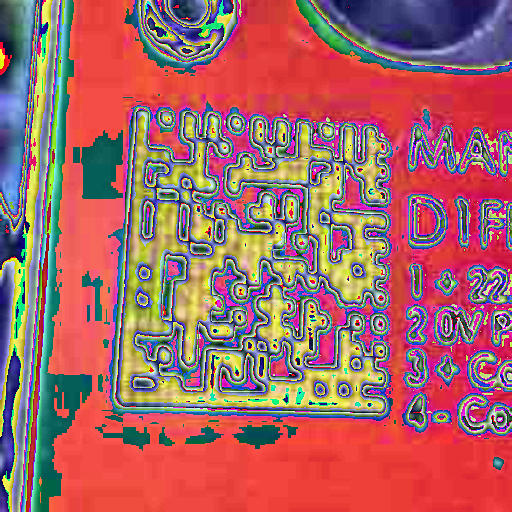

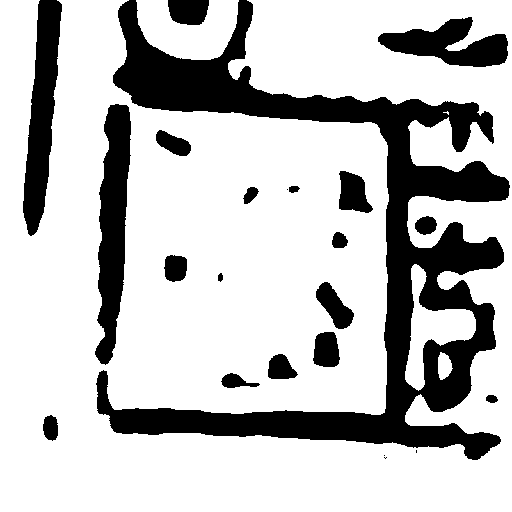


3/50
Dm decode rate: 0.06
Valid decode rate: 0.06


In [14]:
decoding_pipeline(model_yolo, model_binarizer, f'{root_dir}/data/MAN/images/test/*')